# Preparation of the Eye Gazing Sequences 

In [56]:
import pandas as pd
import glob
import os
import matplotlib.pyplot as plt
import numpy as np
import json
import boto3
from loading_s3_data import *
import seaborn as sns
from eye_gazing_analysis import *
from feature_engineering import *
from splitting import *
from resampling import *

In [51]:
import matplotlib as mpl
mpl.rcParams.update(mpl.rcParamsDefault)
mpl.rcParams['agg.path.chunksize'] = 0
mpl.rcParams.update( mpl.rc_params() )
plt.rcParams.update({'font.size': 11})
#plt.rcParams.update({'text.usetex': True})
plt.rcParams.update({'text.latex.preamble': 'bold'})
plt.rc('font', family='serif')

In [52]:
%load_ext autoreload

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [53]:
%autoreload 2

## I. We load our data.

In [5]:
df = pd.read_csv('starting_dataset_rekognition_5fps_windows.csv')
df

,Unnamed: 0,video_key,child_id,ASD,age,gender,VideoDuration,VideoFrameRate,VideoFrameHeight,VideoFrameWidth,...,fps,number_of_frames,total_confidence,number_of_frames_with_face,confidences,eye_directions,eye_directions_windows,confidences_windows,total_confidence_windows,number_of_frames_with_face_windows
0,0,sagacoatings%40gmail.com/1649003460274/GuessWh...,sagacoatings@gmail.com__lynette,1,10.0,Female,57.6,29.8,600.0,800.0,...,14.895833,286,99.303988,276,"[99.46644592285156, 99.42637252807617, 99.0805...","[[-2.819887161254883, -5.989731550216675], [-2...","[[[-2.819887161254883, -5.989731550216675], [-...","[[99.46644592285156, 99.42637252807617, 99.080...",[99.30398800062096],[276]
1,1,sagacoatings%40gmail.com/1649443677729/GuessWh...,sagacoatings@gmail.com__lynette,1,10.0,Female,57.7,29.8,600.0,800.0,...,14.887348,285,97.441161,224,"[99.8779296875, 99.06116104125977, 99.02965927...","[[-8.003300189971924, -8.592330932617188], [-7...","[[[-8.003300189971924, -8.592330932617188], [-...","[[99.8779296875, 99.06116104125977, 99.0296592...","[97.61661138290015, 97.03865802989287]","[156, 68]"
2,2,_REVIEWED/remote_participants/claudiarathwick@...,claudiarathwick@gmail.com__Jacob,1,7.0,Male,89.1,25.0,360.0,480.0,...,11.223345,500,99.187526,173,"[99.99994659423828, 99.99987030029297, 100.0, ...","[[0.6411803960800171, 1.985705316066742], [6.3...","[[[0.6411803960800171, 1.985705316066742], [6....","[[99.99994659423828, 99.99987030029297, 100.0,...","[99.90598487854004, 99.38115383329846, 98.7669...","[4, 21, 72, 3, 66, 7]"
3,3,sherylflynn5@gmail.com/1649453242/GuessWhat.mp4,sherylflynn5@gmail.com__AJ Nowosielski,1,0.0,Male,92.6,25.0,360.0,480.0,...,10.799136,496,98.854258,257,"[99.99876403808594, None, None, None, None, No...","[[-23.315263748168945, -3.1237051486968994], [...","[[[-23.315263748168945, -3.1237051486968994]],...","[[99.99876403808594], [98.67819213867188, 93.0...","[99.99876403808594, 98.21808433532715, 99.0151...","[1, 38, 68, 10, 10, 39, 91]"
4,4,sherylflynn5@gmail.com/1649211315/GuessWhat.mp4,sherylflynn5@gmail.com__AJ Nowosielski,1,0.0,Male,94.6,25.0,360.0,480.0,...,10.570825,488,98.849446,255,"[99.92616271972656, None, None, None, 99.97464...","[[13.27838134765625, -2.3714399337768555], [No...","[[[13.27838134765625, -2.3714399337768555], [N...","[[99.92616271972656, None, None, None, 99.9746...","[98.24194145202637, 98.82518941705877, 99.7353...","[8, 11, 103, 50, 35, 21, 27]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
577,623,sabrinfatemaa%40gmail.com/1606342685563/GuessW...,sabrinfatemaa@gmail.com__Apurbo,0,11.0,Male,57.6,30.0,768.0,1024.0,...,9.982639,288,98.742166,241,"[99.99999618530273, 99.0078353881836, None, No...","[[-2.055677354335785, -8.819129943847656], [-2...","[[[-2.055677354335785, -8.819129943847656], [-...","[[99.99999618530273, 99.0078353881836, None, N...",[98.74216594142044],[241]
578,624,sabrinfatemaa%40gmail.com/1606342771646/GuessW...,sabrinfatemaa@gmail.com__Apurbo,0,11.0,Male,57.5,29.9,768.0,1024.0,...,14.973913,287,99.200617,256,"[99.99948120117188, 99.99454879760742, 99.9986...","[[4.483477592468262, -9.937378883361816], [3.9...","[[[4.483477592468262, -9.937378883361816], [3....","[[99.99948120117188, 99.99454879760742, 99.998...",[99.2006166279316],[256]
579,625,sabrinfatemaa%40gmail.com/1606342869983/GuessW...,sabrinfatemaa@gmail.com__Apurbo,0,11.0,Male,57.5,30.0,768.0,1024.0,...,9.982609,287,99.548925,265,"[99.99890899658203, 99.99998092651367, 100.0, ...","[[11.267480850219727, -12.519931316375732], [5...","[[[11.267480850219727, -12.519931316375732], [...","[[99.99890899658203, 99.99998092651367, 100.0,...",[99.54892455766786],[265]
580,626,sabrinfatemaa%40gmail.com/1606343041328/GuessW...,sabrinfatemaa@gmail.com__Apurbo,0,11.0,Male,57.4,29.9,768.0,1024.0,...,14.982578,287,98.622483,238,"[99.00126266479492, 99.44585037231445, 99.0073...","[[10.24967098236084, 4.20268702507019], [10.02...","[[[10.24967098236084, 4.20268702507019], 

### We drop videos that have been flagged.

In [6]:
df_flag = pd.read_csv("starting_dataset_rekognition_extracted_tested_with_flag.csv")

In [7]:
#if the flag is 0, then the video is bad and we filter it out from df
df = df[df_flag['flag'] == 1]
df

<ipython-input-7-8738bc7066d6>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df = df[df_flag['flag'] == 1]


,Unnamed: 0,video_key,child_id,ASD,age,gender,VideoDuration,VideoFrameRate,VideoFrameHeight,VideoFrameWidth,...,fps,number_of_frames,total_confidence,number_of_frames_with_face,confidences,eye_directions,eye_directions_windows,confidences_windows,total_confidence_windows,number_of_frames_with_face_windows
0,0,sagacoatings%40gmail.com/1649003460274/GuessWh...,sagacoatings@gmail.com__lynette,1,10.0,Female,57.6,29.8,600.0,800.0,...,14.895833,286,99.303988,276,"[99.46644592285156, 99.42637252807617, 99.0805...","[[-2.819887161254883, -5.989731550216675], [-2...","[[[-2.819887161254883, -5.989731550216675], [-...","[[99.46644592285156, 99.42637252807617, 99.080...",[99.30398800062096],[276]
1,1,sagacoatings%40gmail.com/1649443677729/GuessWh...,sagacoatings@gmail.com__lynette,1,10.0,Female,57.7,29.8,600.0,800.0,...,14.887348,285,97.441161,224,"[99.8779296875, 99.06116104125977, 99.02965927...","[[-8.003300189971924, -8.592330932617188], [-7...","[[[-8.003300189971924, -8.592330932617188], [-...","[[99.8779296875, 99.06116104125977, 99.0296592...","[97.61661138290015, 97.03865802989287]","[156, 68]"
2,2,_REVIEWED/remote_participants/claudiarathwick@...,claudiarathwick@gmail.com__Jacob,1,7.0,Male,89.1,25.0,360.0,480.0,...,11.223345,500,99.187526,173,"[99.99994659423828, 99.99987030029297, 100.0, ...","[[0.6411803960800171, 1.985705316066742], [6.3...","[[[0.6411803960800171, 1.985705316066742], [6....","[[99.99994659423828, 99.99987030029297, 100.0,...","[99.90598487854004, 99.38115383329846, 98.7669...","[4, 21, 72, 3, 66, 7]"
3,3,sherylflynn5@gmail.com/1649453242/GuessWhat.mp4,sherylflynn5@gmail.com__AJ Nowosielski,1,0.0,Male,92.6,25.0,360.0,480.0,...,10.799136,496,98.854258,257,"[99.99876403808594, None, None, None, None, No...","[[-23.315263748168945, -3.1237051486968994], [...","[[[-23.315263748168945, -3.1237051486968994]],...","[[99.99876403808594], [98.67819213867188, 93.0...","[99.99876403808594, 98.21808433532715, 99.0151...","[1, 38, 68, 10, 10, 39, 91]"
4,4,sherylflynn5@gmail.com/1649211315/GuessWhat.mp4,sherylflynn5@gmail.com__AJ Nowosielski,1,0.0,Male,94.6,25.0,360.0,480.0,...,10.570825,488,98.849446,255,"[99.92616271972656, None, None, None, 99.97464...","[[13.27838134765625, -2.3714399337768555], [No...","[[[13.27838134765625, -2.3714399337768555], [N...","[[99.92616271972656, None, None, None, 99.9746...","[98.24194145202637, 98.82518941705877, 99.7353...","[8, 11, 103, 50, 35, 21, 27]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
577,623,sabrinfatemaa%40gmail.com/1606342685563/GuessW...,sabrinfatemaa@gmail.com__Apurbo,0,11.0,Male,57.6,30.0,768.0,1024.0,...,9.982639,288,98.742166,241,"[99.99999618530273, 99.0078353881836, None, No...","[[-2.055677354335785, -8.819129943847656], [-2...","[[[-2.055677354335785, -8.819129943847656], [-...","[[99.99999618530273, 99.0078353881836, None, N...",[98.74216594142044],[241]
578,624,sabrinfatemaa%40gmail.com/1606342771646/GuessW...,sabrinfatemaa@gmail.com__Apurbo,0,11.0,Male,57.5,29.9,768.0,1024.0,...,14.973913,287,99.200617,256,"[99.99948120117188, 99.99454879760742, 99.9986...","[[4.483477592468262, -9.937378883361816], [3.9...","[[[4.483477592468262, -9.937378883361816], [3....","[[99.99948120117188, 99.99454879760742, 99.998...",[99.2006166279316],[256]
579,625,sabrinfatemaa%40gmail.com/1606342869983/GuessW...,sabrinfatemaa@gmail.com__Apurbo,0,11.0,Male,57.5,30.0,768.0,1024.0,...,9.982609,287,99.548925,265,"[99.99890899658203, 99.99998092651367, 100.0, ...","[[11.267480850219727, -12.519931316375732], [5...","[[[11.267480850219727, -12.519931316375732], [...","[[99.99890899658203, 99.99998092651367, 100.0,...",[99.54892455766786],[265]
580,626,sabrinfatemaa%40gmail.com/1606343041328/GuessW...,sabrinfatemaa@gmail.com__Apurbo,0,11.0,Male,57.4,29.9,768.0,1024.0,...,14.982578,287,98.622483,238,"[99.00126266479492, 99.44585037231445, 99.0073...","[[10.24967098236084, 4.20268702507019], [10.02...","[[[10.24967098236084, 4.20268702507019], 

In [8]:
#We make that the following columns are lists : eye_directions_windows, confidences_windows, total_confidence_windows, number_of_frames_with_face_windows
#We apply eval to each column
df['eye_directions_windows'] = df['eye_directions_windows'].apply(eval)
df['confidences_windows'] = df['confidences_windows'].apply(eval)
df['total_confidence_windows'] = df['total_confidence_windows'].apply(eval)
df['number_of_frames_with_face_windows'] = df['number_of_frames_with_face_windows'].apply(eval)

<ipython-input-8-ae037f3be5ad>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['eye_directions_windows'] = df['eye_directions_windows'].apply(eval)
<ipython-input-8-ae037f3be5ad>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['confidences_windows'] = df['confidences_windows'].apply(eval)
<ipython-input-8-ae037f3be5ad>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the document

## We add NT rows

In [10]:
df.head()

,Unnamed: 0,video_key,child_id,ASD,age,gender,VideoDuration,VideoFrameRate,VideoFrameHeight,VideoFrameWidth,...,eye_directions,eye_directions_windows,confidences_windows,total_confidence_windows,number_of_frames_with_face_windows,max_window_size,eye_directions_max_window_size,confidences_max_window_size,total_confidence_max_window_size,number_of_frames_with_face_max_window_size
0,0,sagacoatings%40gmail.com/1649003460274/GuessWh...,sagacoatings@gmail.com__lynette,1,10.0,Female,57.6,29.8,600.0,800.0,...,"[[-2.819887161254883, -5.989731550216675], [-2...","[[[-2.819887161254883, -5.989731550216675], [-...","[[99.46644592285156, 99.42637252807617, 99.080...",[99.30398800062096],[276],276,"[[-2.819887161254883, -5.989731550216675], [-2...","[99.46644592285156, 99.42637252807617, 99.0805...",99.303988,276
1,1,sagacoatings%40gmail.com/1649443677729/GuessWh...,sagacoatings@gmail.com__lynette,1,10.0,Female,57.7,29.8,600.0,800.0,...,"[[-8.003300189971924, -8.592330932617188], [-7...","[[[-8.003300189971924, -8.592330932617188], [-...","[[99.8779296875, 99.06116104125977, 99.0296592...","[97.61661138290015, 97.03865802989287]","[156, 68]",156,"[[-8.003300189971924, -8.592330932617188], [-7...","[99.8779296875, 99.06116104125977, 99.02965927...",97.616611,156
2,2,_REVIEWED/remote_participants/claudiarathwick@...,claudiarathwick@gmail.com__Jacob,1,7.0,Male,89.1,25.0,360.0,480.0,...,"[[0.6411803960800171, 1.985705316066742], [6.3...","[[[0.6411803960800171, 1.985705316066742], [6....","[[99.99994659423828, 99.99987030029297, 100.0,...","[99.90598487854004, 99.38115383329846, 98.7669...","[4, 21, 72, 3, 66, 7]",72,"[[2.4300050735473633, -0.4833460748195648], [N...","[78.8230209350586, None, None, None, 99.992813...",98.766989,72
3,3,sherylflynn5@gmail.com/1649453242/GuessWhat.mp4,sherylflynn5@gmail.com__AJ Nowosielski,1,0.0,Male,92.6,25.0,360.0,480.0,...,"[[-23.315263748168945, -3.1237051486968994], [...","[[[-23.315263748168945, -3.1237051486968994]],...","[[99.99876403808594], [98.67819213867188, 93.0...","[99.99876403808594, 98.21808433532715, 99.0151...","[1, 38, 68, 10, 10, 39, 91]",91,"[[-2.7745728492736816, -7.986929893493652], [-...","[99.98541641235352, 99.99972915649414, 99.9992...",98.531428,91
4,4,sherylflynn5@gmail.com/1649211315/GuessWhat.mp4,sherylflynn5@gmail.com__AJ Nowosielski,1,0.0,Male,94.6,25.0,360.0,480.0,...,"[[13.27838134765625, -2.3714399337768555], [No...","[[[13.27838134765625, -2.3714399337768555], [N...","[[99.92616271972656, None, None, None, 99.9746...","[98.24194145202637, 98.82518941705877, 99.7353...","[8, 11, 103, 50, 35, 21, 27]",103,"[[1.8764745891094208, 7.376553058624268], [-5....","[99.51169967651367, 99.99689483642578, 99.9984...",99.735367,103


## II. We compute max windows and NT rows.

In [17]:
df.reset_index(drop=True, inplace=True)
df['ASD'].value_counts()

1    443
0    125
Name: ASD, dtype: int64

In [18]:
df_final = add_NT_rows(df)
df_final['ASD'].value_counts()

1    443
0    130
Name: ASD, dtype: int64

In [19]:
df_final.head()

,video_key,ASD,child_id,age,gender,eye_directions,confidences,total_confidence,number_of_frames_with_face
0,sagacoatings%40gmail.com/1649003460274/GuessWh...,1,sagacoatings@gmail.com__lynette,10.0,Female,"[[-2.819887161254883, -5.989731550216675], [-2...","[99.46644592285156, 99.42637252807617, 99.0805...",99.303988,276
1,sagacoatings%40gmail.com/1649443677729/GuessWh...,1,sagacoatings@gmail.com__lynette,10.0,Female,"[[-8.003300189971924, -8.592330932617188], [-7...","[99.8779296875, 99.06116104125977, 99.02965927...",97.616611,156
2,_REVIEWED/remote_participants/claudiarathwick@...,1,claudiarathwick@gmail.com__Jacob,7.0,Male,"[[2.4300050735473633, -0.4833460748195648], [N...","[78.8230209350586, None, None, None, 99.992813...",98.766989,72
3,sherylflynn5@gmail.com/1649453242/GuessWhat.mp4,1,sherylflynn5@gmail.com__AJ Nowosielski,0.0,Male,"[[-2.7745728492736816, -7.986929893493652], [-...","[99.98541641235352, 99.99972915649414, 99.9992...",98.531428,91
4,sherylflynn5@gmail.com/1649211315/GuessWhat.mp4,1,sherylflynn5@gmail.com__AJ Nowosielski,0.0,Male,"[[1.8764745891094208, 7.376553058624268], [-5....","[99.51169967651367, 99.99689483642578, 99.9984...",99.735367,103


In [22]:
df = df_final

/Users/mariehuynh/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 0, 'Max window size')

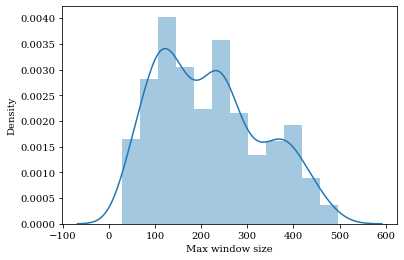

In [25]:
#We plot a histogram of the max window size
sns.distplot(df['number_of_frames_with_face'], kde=True)
plt.xlabel('Max window size')

In [26]:
#We look at the distribution of the max window size
df['number_of_frames_with_face'].describe()

count     573
unique    302
top       233
freq        6
Name: number_of_frames_with_face, dtype: int64

## II. We only keep windows that are more than 20 seconds.

In [28]:
#We look at how many videos have under 20 seconds of eye direction data
temp = df[df['number_of_frames_with_face'] <= 20*5]
temp['ASD'].value_counts()

1    87
Name: ASD, dtype: int64

In [29]:
#We only select the videos with more than 20 seconds of eye direction data
df_final = df[df['number_of_frames_with_face'] > 20*5]
df_final['ASD'].value_counts()

1    356
0    130
Name: ASD, dtype: int64

In [30]:
df_final

,video_key,ASD,child_id,age,gender,eye_directions,confidences,total_confidence,number_of_frames_with_face
0,sagacoatings%40gmail.com/1649003460274/GuessWh...,1,sagacoatings@gmail.com__lynette,10.0,Female,"[[-2.819887161254883, -5.989731550216675], [-2...","[99.46644592285156, 99.42637252807617, 99.0805...",99.303988,276
1,sagacoatings%40gmail.com/1649443677729/GuessWh...,1,sagacoatings@gmail.com__lynette,10.0,Female,"[[-8.003300189971924, -8.592330932617188], [-7...","[99.8779296875, 99.06116104125977, 99.02965927...",97.616611,156
4,sherylflynn5@gmail.com/1649211315/GuessWhat.mp4,1,sherylflynn5@gmail.com__AJ Nowosielski,0.0,Male,"[[1.8764745891094208, 7.376553058624268], [-5....","[99.51169967651367, 99.99689483642578, 99.9984...",99.735367,103
5,lavalleevalerie@yahoo.com/1646879575/GuessWhat...,1,lavalleevalerie@yahoo.com__Catherine Lavallee,0.0,Female,"[[-3.2374602556228638, -5.52520489692688], [-6...","[99.98519134521484, 99.86570358276367, 99.9819...",99.855054,416
6,lavalleevalerie@yahoo.com/1645389917/GuessWhat...,1,lavalleevalerie@yahoo.com__Catherine Lavallee,0.0,Female,"[[-12.626811981201172, -10.13326382637024], [N...","[90.93453216552734, None, 99.99822998046875, 9...",98.401824,140
...,...,...,...,...,...,...,...,...,...
568,sabrinfatemaa%40gmail.com/1606342685563/GuessW...,0,sabrinfatemaa@gmail.com__Apurbo,11.0,Male,"[[-2.055677354335785, -8.819129943847656], [-2...","[99.99999618530273, 99.0078353881836, None, No...",98.742166,241
569,sabrinfatemaa%40gmail.com/1606342771646/GuessW...,0,sabrinfatemaa@gmail.com__Apurbo,11.0,Male,"[[4.483477592468262, -9.937378883361816], [3.9...","[99.99948120117188, 99.99454879760742, 99.9986...",99.200617,256
570,sabrinfatemaa%40gmail.com/1606342869983/GuessW...,0,sabrinfatemaa@gmail.com__Apurbo,11.0,Male,"[[11.267480850219727, -12.519931316375732], [5...","[99.99890899658203, 99.99998092651367, 100.0, ...",99.548925,265
571,sabrinfatemaa%40gmail.com/1606343041328/GuessW...,0,sabrinfatemaa@gmail.com__Apurbo,11.0,Male,"[[10.24967098236084, 4.20268702507019], [10.02...","[99.00126266479492, 99.44585037231445, 99.0073...",98.622483,238


In [31]:
df_final.reset_index(inplace=True, drop=True)

## III. We normalize the features.


In [32]:
features = df_final['eye_directions'].tolist()
features

[[[-2.819887161254883, -5.989731550216675],
  [-2.6659501791000366, -4.494826674461365],
  [-0.9277238547801971, -4.269177675247192],
  [-1.840688943862915, -5.563696622848511],
  [-3.292689323425293, -7.848320007324219],
  [-0.4207380786538124, -4.832557201385498],
  [-1.0448187589645386, -5.400401592254639],
  [-2.5682214498519897, -5.186372518539429],
  [-5.191657543182373, -1.6423304229974747],
  [-2.671225428581238, -1.555353045463562],
  [-0.7459897845983505, -1.8565164804458618],
  [-1.5282617211341858, -1.9581993222236633],
  [-2.6489895582199097, -1.7826271653175354],
  [-2.571810245513916, -1.8920015096664429],
  [-2.4343637228012085, -1.1694372296333313],
  [-3.009658098220825, -0.9422000050544739],
  [-4.622380375862122, -0.7994718551635742],
  [-5.033502578735352, -2.46248459815979],
  [-5.0278000831604, -3.202080011367798],
  [-5.687766790390015, -3.7147642374038696],
  [-5.825524568557739, -3.9623138904571533],
  [-5.492664575576782, -3.367981195449829],
  [-4.8754959106

In [35]:
#We standardize the data

from sklearn.preprocessing import StandardScaler
# Assuming 'videos' is your list of videos
# Each video is a list (or array) of frames, and each frame has width-2 features
# Example: videos = [video1, video2, ..., videoN]
# where video1 = [frame1, frame2, ..., frameM] and frame1 = [feature1, feature2]

normalized_videos = []

for video in features:
    # Create a new scaler for each video
    scaler = StandardScaler()

    # Convert video to a 2D array if it's not already (each row is a frame)
    video_array = np.array(video)  # Assuming video is already a 2D array-like structure

    # Fit and transform the scaler to this video
    normalized_video = scaler.fit_transform(video_array)

    # Append the normalized video to the list
    normalized_videos.append(normalized_video)

In [36]:
normalized_videos

[array([[ 0.62041088, -0.37809099],
        [ 0.65021745,  0.03015273],
        [ 0.98678734,  0.09177523],
        [ 0.81001142, -0.26174507],
        [ 0.52886298, -0.88565309],
        [ 1.08495416, -0.06207814],
        [ 0.96411445, -0.21715082],
        [ 0.6691405 , -0.1587016 ],
        [ 0.1611689 ,  0.8091412 ],
        [ 0.64919601,  0.83289386],
        [ 1.02197621,  0.75064911],
        [ 0.87050619,  0.72288053],
        [ 0.65350151,  0.77082755],
        [ 0.66844561,  0.7409585 ],
        [ 0.69505915,  0.93828365],
        [ 0.58366585,  1.00033988],
        [ 0.2713971 ,  1.03931753],
        [ 0.19179219,  0.58516522],
        [ 0.19289635,  0.38318904],
        [ 0.06510809,  0.24318005],
        [ 0.03843428,  0.17557669],
        [ 0.10288541,  0.33788307],
        [ 0.22238676,  0.06420145],
        [ 0.34740732, -0.04964621],
        [ 0.04890367,  0.11050822],
        [ 0.21846835,  0.24764616],
        [ 0.39644619,  0.28358095],
        [ 0.3015974 ,  0.082

In [44]:
#We add a 1 to the end of every frame if the values are different from nan :
normalized_videos_zeros = []
for video in normalized_videos:
    new_video = []
    for frame in video:
            if not np.isnan(frame[0]):
                frame = list(frame) + [1]
            else:
                frame = [0, 0, 0]
            new_video.append(frame)

    normalized_videos_zeros.append(new_video)

normalized_videos_zeros

[[[0.6204108848115549, -0.37809099145822855, 1],
  [0.6502174484183393, 0.03015272500346109, 1],
  [0.9867873406792499, 0.09177523192619122, 1],
  [0.8100114183661535, -0.26174507212112824, 1],
  [0.5288629830475612, -0.8856530921698305, 1],
  [1.084954159154652, -0.06207813711370875, 1],
  [0.9641144477801927, -0.21715081649286616, 1],
  [0.669140500850353, -0.15870159614350915, 1],
  [0.16116890306023576, 0.8091412009774117, 1],
  [0.6491960105740862, 0.8328938613830414, 1],
  [1.0219762085300317, 0.7506491099252457, 1],
  [0.8705061854870749, 0.7228805328732899, 1],
  [0.6535015054265866, 0.7708275501083081, 1],
  [0.6684456082737182, 0.7409584998786083, 1],
  [0.6950591514549574, 0.9382836486872512, 1],
  [0.583665851719347, 1.0003398842277504, 1],
  [0.2713971007298035, 1.0393175284244904, 1],
  [0.1917921876116827, 0.5851652183111808, 1],
  [0.19289635241141365, 0.3831890357039086, 1],
  [0.06510808891530317, 0.24318005105028598, 1],
  [0.03843427785438971, 0.1755766924618588, 1]

In [47]:
df_final['eye_directions_normalized'] = normalized_videos_zeros

<ipython-input-47-ebe3b376bb93>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_final['eye_directions_normalized'] = normalized_videos_zeros


In [48]:
df_final

,video_key,ASD,child_id,age,gender,eye_directions,confidences,total_confidence,number_of_frames_with_face,eye_directions_normalized
0,sagacoatings%40gmail.com/1649003460274/GuessWh...,1,sagacoatings@gmail.com__lynette,10.0,Female,"[[-2.819887161254883, -5.989731550216675], [-2...","[99.46644592285156, 99.42637252807617, 99.0805...",99.303988,276,"[[0.6204108848115549, -0.37809099145822855, 1]..."
1,sagacoatings%40gmail.com/1649443677729/GuessWh...,1,sagacoatings@gmail.com__lynette,10.0,Female,"[[-8.003300189971924, -8.592330932617188], [-7...","[99.8779296875, 99.06116104125977, 99.02965927...",97.616611,156,"[[-0.15865711676521804, -1.5337594511563462, 1..."
2,sherylflynn5@gmail.com/1649211315/GuessWhat.mp4,1,sherylflynn5@gmail.com__AJ Nowosielski,0.0,Male,"[[1.8764745891094208, 7.376553058624268], [-5....","[99.51169967651367, 99.99689483642578, 99.9984...",99.735367,103,"[[0.22359787426406258, 1.5568372425052852, 1],..."
3,lavalleevalerie@yahoo.com/1646879575/GuessWhat...,1,lavalleevalerie@yahoo.com__Catherine Lavallee,0.0,Female,"[[-3.2374602556228638, -5.52520489692688], [-6...","[99.98519134521484, 99.86570358276367, 99.9819...",99.855054,416,"[[-0.1666276750931965, -0.82073862242007, 1], ..."
4,lavalleevalerie@yahoo.com/1645389917/GuessWhat...,1,lavalleevalerie@yahoo.com__Catherine Lavallee,0.0,Female,"[[-12.626811981201172, -10.13326382637024], [N...","[90.93453216552734, None, 99.99822998046875, 9...",98.401824,140,"[[-1.645323310965547, 0.8545815452335914, 1], ..."
...,...,...,...,...,...,...,...,...,...,...
481,sabrinfatemaa%40gmail.com/1606342685563/GuessW...,0,sabrinfatemaa@gmail.com__Apurbo,11.0,Male,"[[-2.055677354335785, -8.819129943847656], [-2...","[99.99999618530273, 99.0078353881836, None, No...",98.742166,241,"[[0.0973290992767213, -1.7301497485058053, 1],..."
482,sabrinfatemaa%40gmail.com/1606342771646/GuessW...,0,sabrinfatemaa@gmail.com__Apurbo,11.0,Male,"[[4.483477592468262, -9.937378883361816], [3.9...","[99.99948120117188, 99.99454879760742, 99.9986...",99.200617,256,"[[2.2412372406710745, 1.8091900226862576, 1], ..."
483,sabrinfatemaa%40gmail.com/1606342869983/GuessW...,0,sabrinfatemaa@gmail.com__Apurbo,11.0,Male,"[[11.267480850219727, -12.519931316375732], [5...","[99.99890899658203, 99.99998092651367, 100.0, ...",99.548925,265,"[[1.898762844665513, 0.041159440476586734, 1],..."
484,sabrinfatemaa%40gmail.com/1606343041328/GuessW...,0,sabrinfatemaa@gmail.com__Apurbo,11.0,Male,"[[10.24967098236084, 4.20268702507019], [10.02...","[99.00126266479492, 99.44585037231445, 99.0073...",98.622483,238,"[[1.6575097851176468, -0.24514500814306697, 1]..."


## IV. We save the data.

In [49]:
df_final.to_csv('starting_dataset_rekognition_preprocessed_5fps_windows_normalized.csv', index=False)

## V. We split the data.

In [54]:
train_df, val_df, test_df = split_train_val_test(df_final)

In [57]:
train_df_upsampled = upsample(train_df)

['+19894675653__Mohan raj' 'annaweissman@gmail.com__Sam'
 'katiarendongeorge@gmail.com__Natasha'
 'keepitsimpledmv@gmail.com__Julian' 'knitsandgiggles5@gmail.com__Malin'
 'matt_savage@sbcglobal.net__Easton' 'sarasatindavis@hotmail.com__Esther'
 'sgosche@hotmail.com__Melanie' 'anowar6387@gmail.com__Arosh'
 'taniaislam56@gmail.com__Mansib' 'sagor@geekysocial.com__Arham Hasan'
 'balagotc@gmail.com__Lincoln' 'gabeljennifer4@gmail.com__Mackenzie'
 'rteisch36@gmail.com__Dov' 'tabatharainwater@gmail.com__Nora'
 'anasli@gmail.com__Kendall' 'annaseemayer@yahoo.co.uk__Catherine'
 'billypano@hotmail.com__Alex' 'briannaingridjacobs@gmail.com__Hudson'
 'cumlupo@gmail.com__Gaming' 'jenhicks@stanford.edu__Juliet'
 'juliannjenne@gmail.com__Rachel' 'karimibshiva@gmail.com__Ava'
 'm2oee20@gmail.com__Ellie' 'pmcrimson@gmail.com__Neil'
 'radhikamittal@gmail.com__Vihhaan agarwal' 'redhddgull@gmail.com__Lil'
 'sabrinfatemaa@gmail.com__Apurbo']


In [61]:
train_df.to_csv('../eye_gazing/splits/starting_dataset/5_fps_zeros_final_preprocessing/train.csv', index=False)
val_df.to_csv('../eye_gazing/splits/starting_dataset/5_fps_zeros_final_preprocessing/val.csv', index=False)
test_df.to_csv('../eye_gazing/splits/starting_dataset/5_fps_zeros_final_preprocessing/test.csv', index=False)
train_df_upsampled.to_csv('../eye_gazing/splits/starting_dataset/5_fps_zeros_final_preprocessing/train_upsampled.csv', index=False)